### Dataset:
NYC Shooting Incident Dataset

- Dataset Description: Historical dataset of NYC shooting incidents.
- Columns: OCCUR_DATE, OCCUR_TIME, BORO, PRECINCT, JURISDICTION_CODE, LOCATION_DESC, STATISTICAL_MURDER_FLAG, PERP_AGE_GROUP, PERP_SEX, PERP_RACE, VIC_AGE_GROUP, VIC_SEX, VIC_RACE, X_COORD_CD, Y_COORD_CD, Latitude, Longitude, Lon_Lat.
- Purpose: To document and analyze shooting incidents in New York City.
- Applications: Public safety analysis, policy-making, crime trend monitoring, and resource allocation.
- Analysis Tasks: Trend analysis, geographical distribution mapping, demographic studies, and crime pattern identification.
- Relevance: Vital for understanding crime dynamics, informing law enforcement strategies, and enhancing community safety measures.

## Step 1: Importing Libraries

In [1]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")

## Step 2: Loading the dataset

In [2]:
data = pd.read_csv(r'C:\Users\Sakshi\Documents\BIA\capstron project\NYPD_Shooting_Incident_Data__Historic_.csv')

In [3]:
data.head()

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,228798151,05/27/2021,21:30:00,QUEENS,NaN,105,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1.058925e+06,180924.000000,40.662965,-73.730839,POINT (-73.73083868899994 40.662964620000025)
1,137471050,06/27/2014,17:40:00,BRONX,NaN,40,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1.005028e+06,234516.000000,40.810352,-73.924942,POINT (-73.92494232599995 40.81035186300006)
2,147998800,11/21/2015,03:56:00,QUEENS,NaN,108,0.0,NaN,NaN,True,...,NaN,NaN,25-44,M,WHITE,1.007668e+06,209836.531250,40.742607,-73.915492,POINT (-73.91549174199997 40.74260663300004)
3,146837977,10/09/2015,18:30:00,BRONX,NaN,44,0.0,NaN,NaN,False,...,NaN,NaN,<18,M,WHITE HISPANIC,1.006537e+06,244511.140625,40.837782,-73.919457,POINT (-73.91945661499994 40.83778200300003)
4,58921844,02/19/2009,22:58:00,BRONX,NaN,47,0.0,NaN,NaN,True,...,M,BLACK,45-64,M,BLACK,1.024922e+06,262189.406250,40.886238,-73.852910,POINT (-73.85290950899997 40.88623791800006)


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27312 entries, 0 to 27311
Data columns (total 21 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   INCIDENT_KEY             27312 non-null  int64  
 1   OCCUR_DATE               27312 non-null  object 
 2   OCCUR_TIME               27312 non-null  object 
 3   BORO                     27312 non-null  object 
 4   LOC_OF_OCCUR_DESC        1716 non-null   object 
 5   PRECINCT                 27312 non-null  int64  
 6   JURISDICTION_CODE        27310 non-null  float64
 7   LOC_CLASSFCTN_DESC       1716 non-null   object 
 8   LOCATION_DESC            12335 non-null  object 
 9   STATISTICAL_MURDER_FLAG  27312 non-null  bool   
 10  PERP_AGE_GROUP           17968 non-null  object 
 11  PERP_SEX                 18002 non-null  object 
 12  PERP_RACE                18002 non-null  object 
 13  VIC_AGE_GROUP            27312 non-null  object 
 14  VIC_SEX               

In [5]:
data.describe()

,INCIDENT_KEY,PRECINCT,JURISDICTION_CODE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
count,2.731200e+04,27312.000000,27310.000000,2.731200e+04,27312.000000,27302.000000,27302.000000
mean,1.208605e+08,65.635362,0.326913,1.009449e+06,208127.401608,40.737892,-73.909051
std,7.341286e+07,27.305705,0.737743,1.837783e+04,31886.377757,0.087525,0.066272
min,9.953245e+06,1.000000,0.000000,9.149281e+05,125756.718750,40.511586,-74.249303
25%,6.386088e+07,44.000000,0.000000,1.000029e+06,182834.335938,40.668481,-73.943027
50%,9.037222e+07,68.000000,0.000000,1.007731e+06,194486.570312,40.700318,-73.915221
75%,1.888102e+08,81.000000,0.000000,1.016838e+06,239518.468750,40.824067,-73.882330
max,2.611902e+08,123.000000,2.000000,1.066815e+06,271127.687500,40.910818,-73.702046


In [6]:
data.columns.values

array(['INCIDENT_KEY', 'OCCUR_DATE', 'OCCUR_TIME', 'BORO',
       'LOC_OF_OCCUR_DESC', 'PRECINCT', 'JURISDICTION_CODE',
       'LOC_CLASSFCTN_DESC', 'LOCATION_DESC', 'STATISTICAL_MURDER_FLAG',
       'PERP_AGE_GROUP', 'PERP_SEX', 'PERP_RACE', 'VIC_AGE_GROUP',
       'VIC_SEX', 'VIC_RACE', 'X_COORD_CD', 'Y_COORD_CD', 'Latitude',
       'Longitude', 'Lon_Lat'], dtype=object)

## Step 3: Data Preprocessing & EDA

In [7]:
# Convert OCCUR_DATE and OCCUR_TIME to datetime

data['OCCUR_DATE'] = pd.to_datetime(data['OCCUR_DATE'], format='%m/%d/%Y')
data['OCCUR_TIME'] = pd.to_datetime(data['OCCUR_TIME'], format='%H:%M:%S').dt.time

In [8]:
# Standardize categorical values for BORO, PERP_SEX, PERP_RACE, VIC_SEX, VIC_RACE
data['BORO'] = data['BORO'].str.upper().str.strip()
data['PERP_SEX'] = data['PERP_SEX'].str.upper().str.strip()
data['PERP_RACE'] = data['PERP_RACE'].str.upper().str.strip()
data['VIC_SEX'] = data['VIC_SEX'].str.upper().str.strip()
data['VIC_RACE'] = data['VIC_RACE'].str.upper().str.strip()

In [9]:
#checking for missing values

missing_values = data.isnull().sum()
print(missing_values)

INCIDENT_KEY                   0
OCCUR_DATE                     0
OCCUR_TIME                     0
BORO                           0
LOC_OF_OCCUR_DESC          25596
PRECINCT                       0
JURISDICTION_CODE              2
LOC_CLASSFCTN_DESC         25596
LOCATION_DESC              14977
STATISTICAL_MURDER_FLAG        0
PERP_AGE_GROUP              9344
PERP_SEX                    9310
PERP_RACE                   9310
VIC_AGE_GROUP                  0
VIC_SEX                        0
VIC_RACE                       0
X_COORD_CD                     0
Y_COORD_CD                     0
Latitude                      10
Longitude                     10
Lon_Lat                       10
dtype: int64


In [10]:
# Drop columns with too many missing values

columns_to_drop = ['LOC_OF_OCCUR_DESC', 'LOC_CLASSFCTN_DESC']
data_cleaned = data.drop(columns=columns_to_drop)

In [11]:
# Handle rows with missing Latitude, Longitude, and Lon_Lat values
data_cleaned = data_cleaned.dropna(subset=['Latitude', 'Longitude', 'Lon_Lat'])

In [12]:
# For simplicity, we'll fill numerical missing values with the mean and categorical with the mode
numerical_columns = ['JURISDICTION_CODE']
categorical_columns = ['PERP_AGE_GROUP', 'PERP_SEX', 'PERP_RACE', 'LOCATION_DESC']

for col in numerical_columns:
    data_cleaned[col].fillna(data_cleaned[col].mean(), inplace=True)

for col in categorical_columns:
    data_cleaned[col].fillna(data_cleaned[col].mode()[0], inplace=True)

In [13]:
data_cleaned.info()
data_cleaned.head()

<class 'pandas.core.frame.DataFrame'>
Index: 27302 entries, 0 to 27311
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   INCIDENT_KEY             27302 non-null  int64         
 1   OCCUR_DATE               27302 non-null  datetime64[ns]
 2   OCCUR_TIME               27302 non-null  object        
 3   BORO                     27302 non-null  object        
 4   PRECINCT                 27302 non-null  int64         
 5   JURISDICTION_CODE        27302 non-null  float64       
 6   LOCATION_DESC            27302 non-null  object        
 7   STATISTICAL_MURDER_FLAG  27302 non-null  bool          
 8   PERP_AGE_GROUP           27302 non-null  object        
 9   PERP_SEX                 27302 non-null  object        
 10  PERP_RACE                27302 non-null  object        
 11  VIC_AGE_GROUP            27302 non-null  object        
 12  VIC_SEX                  27302 non-nu

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,PRECINCT,JURISDICTION_CODE,LOCATION_DESC,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,228798151,2021-05-27,21:30:00,QUEENS,105,0.0,MULTI DWELL - PUBLIC HOUS,False,18-24,M,BLACK,18-24,M,BLACK,1.058925e+06,180924.000000,40.662965,-73.730839,POINT (-73.73083868899994 40.662964620000025)
1,137471050,2014-06-27,17:40:00,BRONX,40,0.0,MULTI DWELL - PUBLIC HOUS,False,18-24,M,BLACK,18-24,M,BLACK,1.005028e+06,234516.000000,40.810352,-73.924942,POINT (-73.92494232599995 40.81035186300006)
2,147998800,2015-11-21,03:56:00,QUEENS,108,0.0,MULTI DWELL - PUBLIC HOUS,True,18-24,M,BLACK,25-44,M,WHITE,1.007668e+06,209836.531250,40.742607,-73.915492,POINT (-73.91549174199997 40.74260663300004)
3,146837977,2015-10-09,18:30:00,BRONX,44,0.0,MULTI DWELL - PUBLIC HOUS,False,18-24,M,BLACK,<18,M,WHITE HISPANIC,1.006537e+06,244511.140625,40.837782,-73.919457,POINT (-73.91945661499994 40.83778200300003)
4,58921844,2009-02-19,22:58:00,BRONX,47,0.0,MULTI DWELL - PUBLIC HOUS,True,25-44,M,BLACK,45-64,M,BLACK,1.024922e+06,262189.406250,40.886238,-73.852910,POINT (-73.85290950899997 40.88623791800006)


In [14]:
missing = data_cleaned.isnull().sum()
print(missing)

INCIDENT_KEY               0
OCCUR_DATE                 0
OCCUR_TIME                 0
BORO                       0
PRECINCT                   0
JURISDICTION_CODE          0
LOCATION_DESC              0
STATISTICAL_MURDER_FLAG    0
PERP_AGE_GROUP             0
PERP_SEX                   0
PERP_RACE                  0
VIC_AGE_GROUP              0
VIC_SEX                    0
VIC_RACE                   0
X_COORD_CD                 0
Y_COORD_CD                 0
Latitude                   0
Longitude                  0
Lon_Lat                    0
dtype: int64


In [15]:
# Selecting relevant features for clustering
features = ['OCCUR_DATE', 'OCCUR_TIME', 'BORO', 'PRECINCT', 'STATISTICAL_MURDER_FLAG', 'PERP_AGE_GROUP', 'PERP_SEX', 'PERP_RACE', 'VIC_AGE_GROUP', 'VIC_SEX', 'VIC_RACE', 'Latitude', 'Longitude']

In [16]:
# Convert OCCUR_DATE to numerical values (e.g., timestamp)
data_cleaned['OCCUR_DATE'] = data_cleaned['OCCUR_DATE'].apply(lambda x: x.timestamp())

In [17]:
# Convert OCCUR_TIME to minutes since midnight
data_cleaned['OCCUR_TIME'] = data_cleaned['OCCUR_TIME'].apply(lambda x: x.hour * 60 + x.minute)


In [18]:
# One-hot encode categorical features
categorical_features = ['BORO', 'PERP_AGE_GROUP', 'PERP_SEX', 'PERP_RACE', 'VIC_AGE_GROUP', 'VIC_SEX', 'VIC_RACE']
data_encoded = pd.get_dummies(data_cleaned[features], columns=categorical_features)

In [19]:
# Normalize the data
scaler = StandardScaler()
data_normalized = scaler.fit_transform(data_encoded)

In [20]:
# Split the data into training and testing sets
X_train, X_test = train_test_split(data_normalized, test_size=0.2, random_state=42)


In [21]:
# Print the shape of the training and testing sets
print(f'Shape of X_train: {X_train.shape}')
print(f'Shape of X_test: {X_test.shape}')

Shape of X_train: (21841, 50)
Shape of X_test: (5461, 50)


In [22]:
# Explore date and time features
data['OCCUR_DATE'] = pd.to_datetime(data['OCCUR_DATE'], format='%m/%d/%Y')
data['OCCUR_TIME'] = pd.to_datetime(data['OCCUR_TIME'], format='%H:%M:%S').dt.time


### Intepretation
- Age and Race Demographics: Both victim and perpetrator age and race distributions help in understanding which groups are most affected or involved, providing direction for targeted interventions.
- Geographical Patterns: Incident counts by borough and precinct highlight areas with higher activity, crucial for allocating resources and strategizing.
- Temporal Trends: Trends over time, both yearly and monthly, reveal patterns that can inform policing strategies, such as identifying periods requiring increased vigilance.

## Data Exploration
 To understand patterns & potentially form some hypothesis

### 1- Distribution of categorical columns

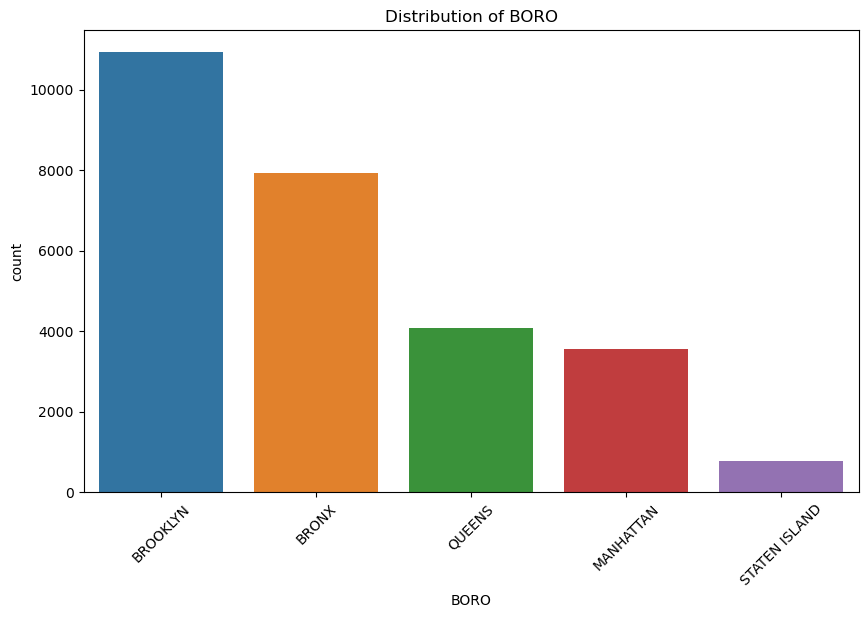

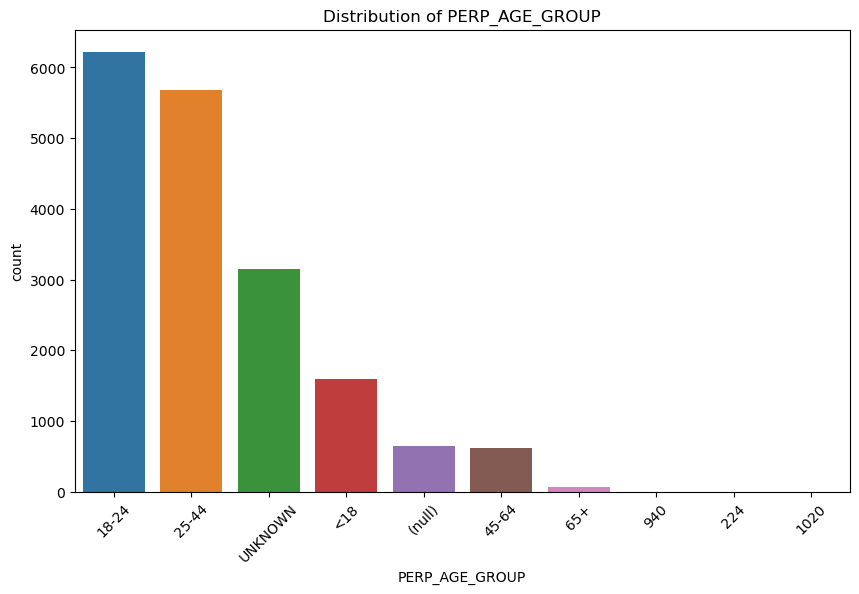

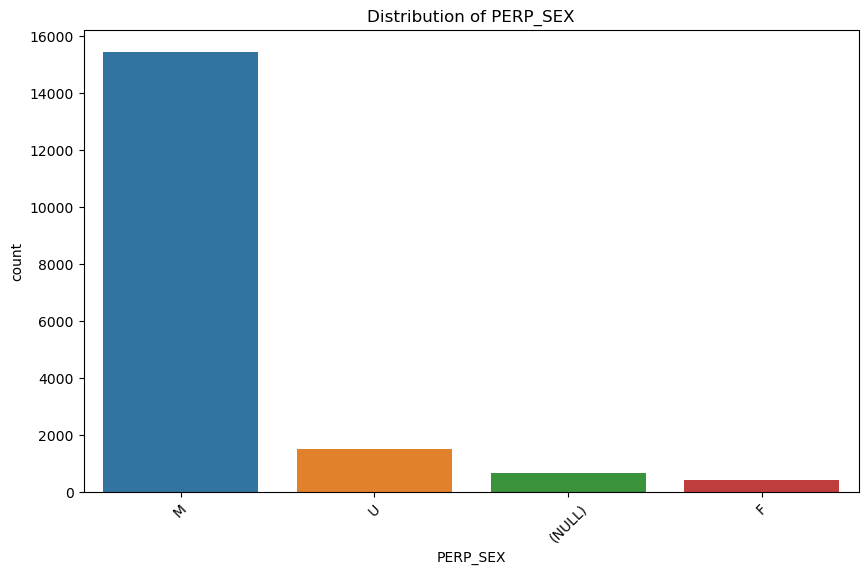

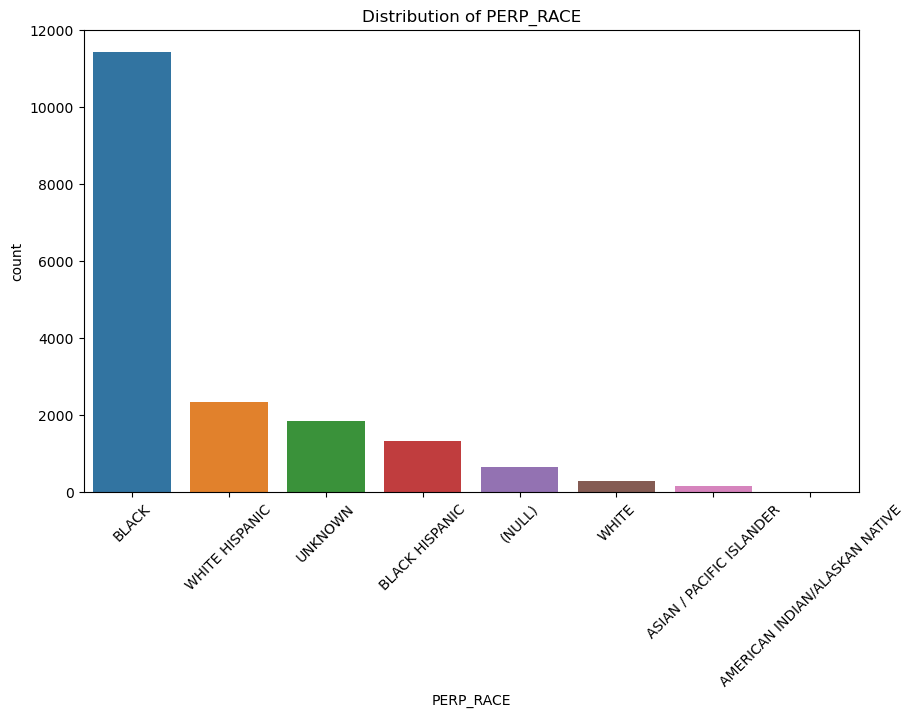

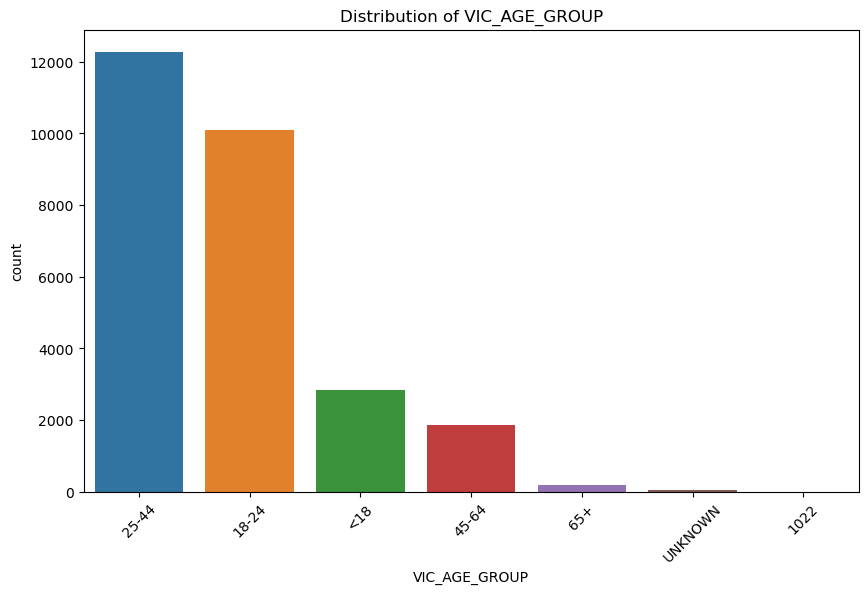

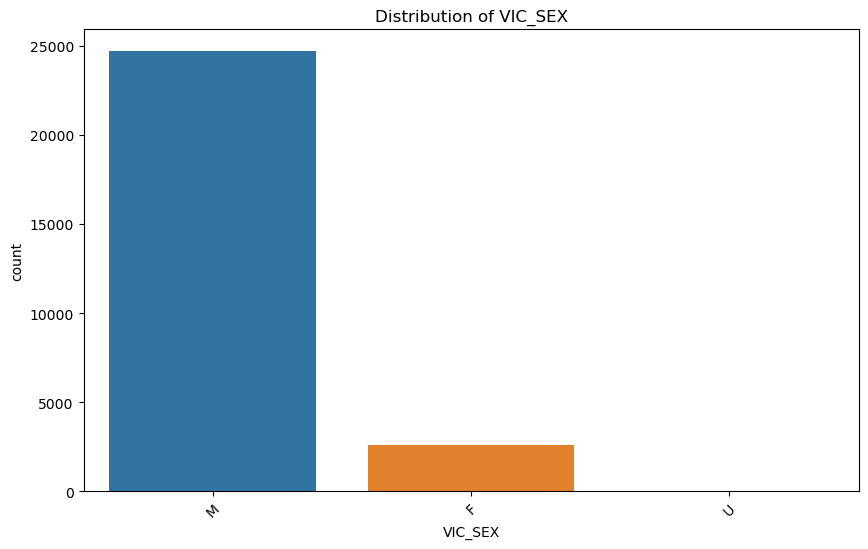

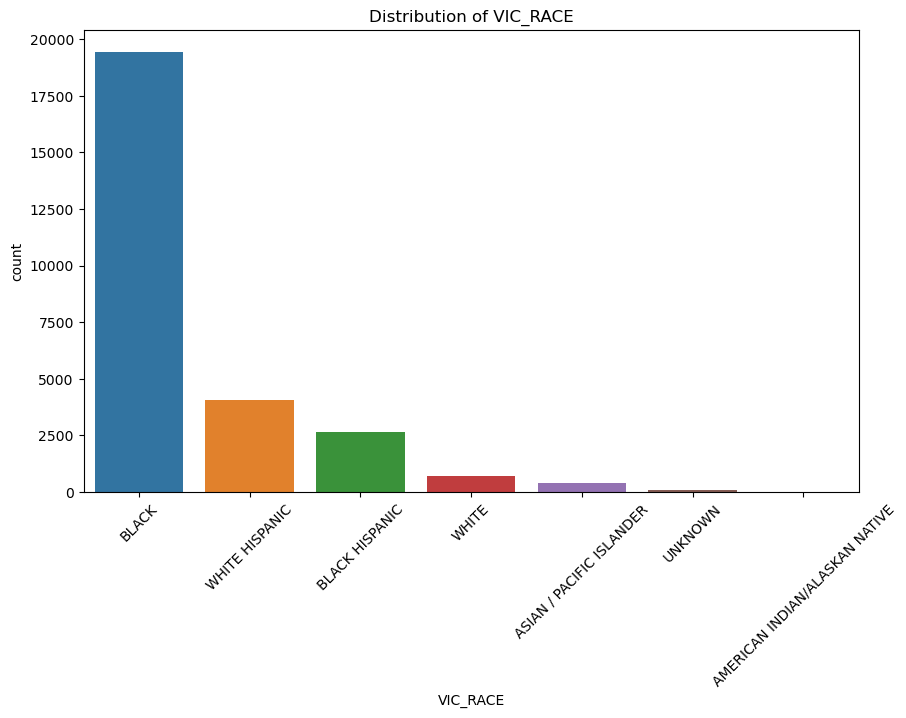

In [23]:
#Distribution of categorical column
for feature in categorical_features:
    plt.figure(figsize=(10, 6))
    sns.countplot(x=data[feature], order=data[feature].value_counts().index)
    plt.title(f'Distribution of {feature}')
    plt.xticks(rotation=45)
    plt.show()

### 2- Destribution of Numerical variables

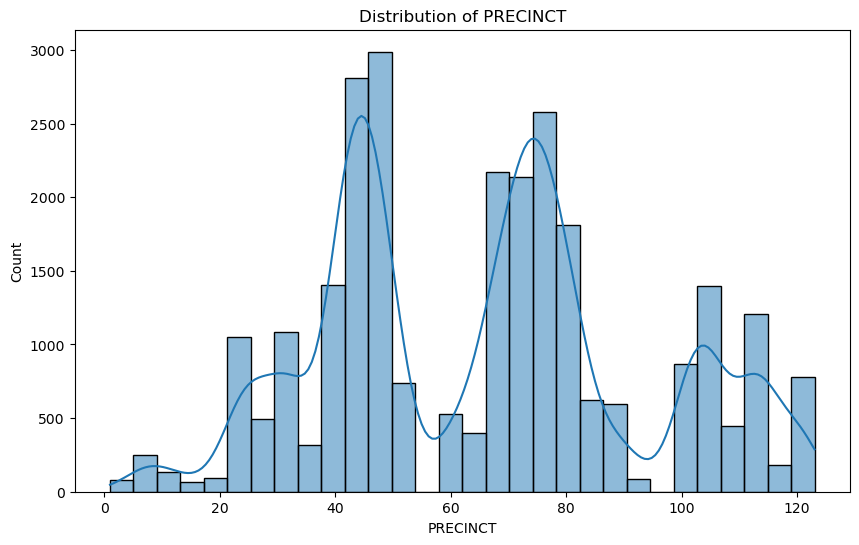

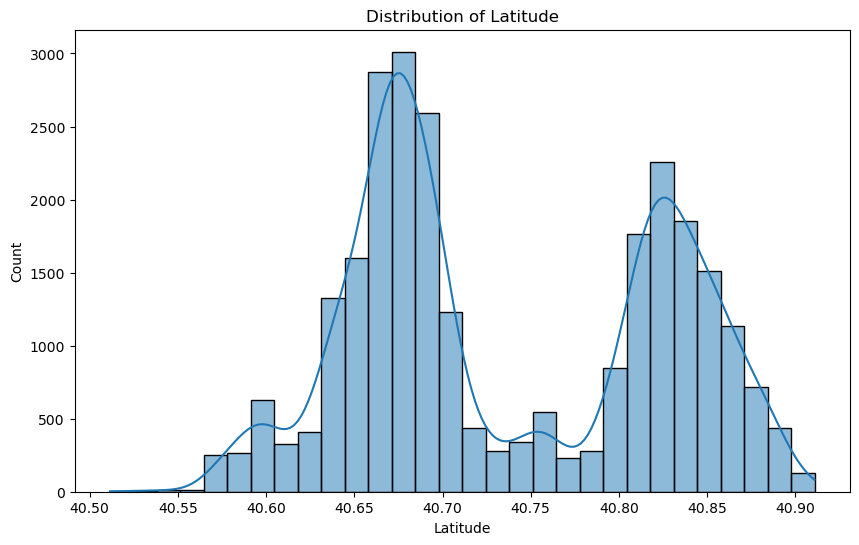

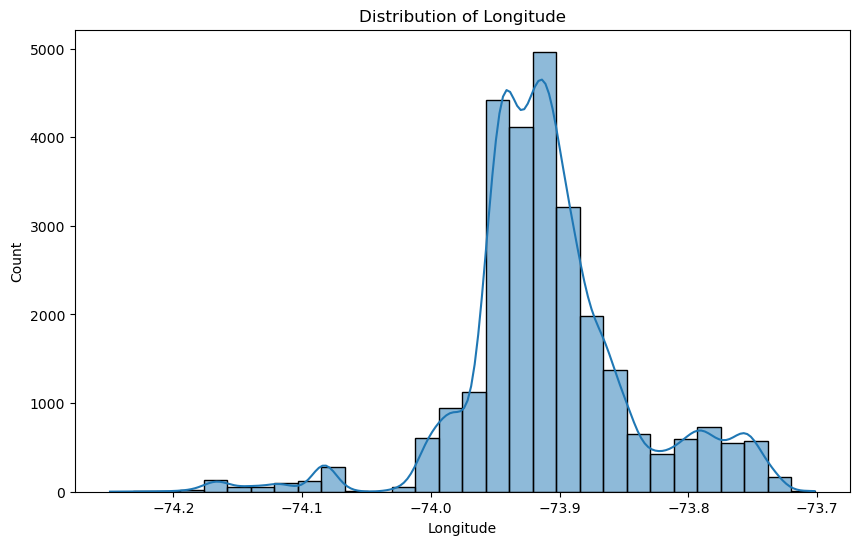

In [24]:
# Distribution of numerical variables
numerical_features = ['PRECINCT', 'Latitude', 'Longitude']
for feature in numerical_features:
    plt.figure(figsize=(10, 6))
    sns.histplot(data[feature], bins=30, kde=True)
    plt.title(f'Distribution of {feature}')
    plt.show()

In [25]:
# Distribution of incidents over time
data['OCCUR_YEAR'] = data['OCCUR_DATE'].dt.year
data['OCCUR_MONTH'] = data['OCCUR_DATE'].dt.month
data['OCCUR_DAY'] = data['OCCUR_DATE'].dt.day
data['OCCUR_HOUR'] = data['OCCUR_TIME'].apply(lambda x: x.hour)

### 3-Number of Incident Over Year

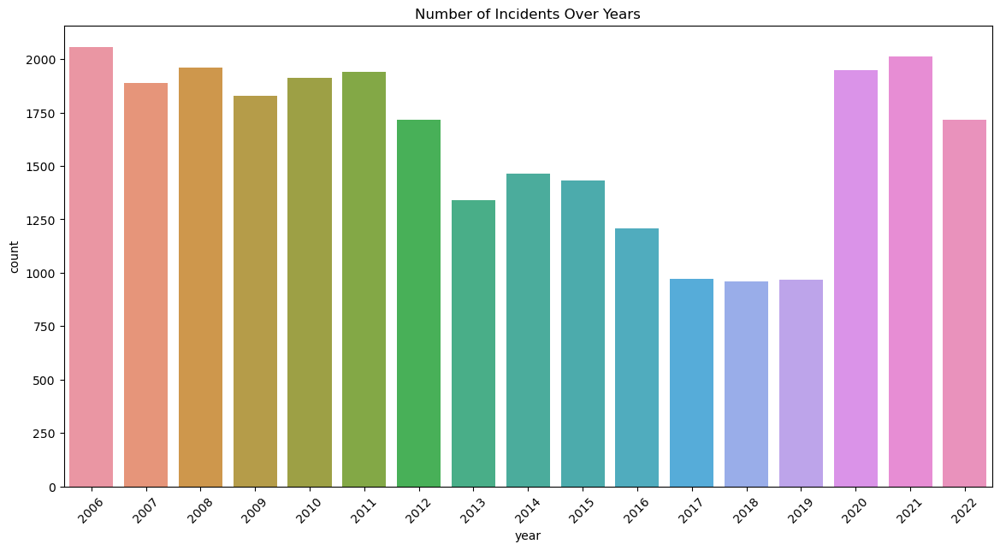

In [26]:
# Plot the number of incidents over years
if 'OCCUR_DATE' in data.columns:
    plt.figure(figsize=(14, 7))
    data['year'] = data['OCCUR_DATE'].dt.year
    sns.countplot(data=data, x='year')
    plt.title('Number of Incidents Over Years')
    plt.xticks(rotation=45)
    plt.show()

Trends may show increases or decreases in incidents over the years, indicating periods of higher activity or effective policing/intervention measures.


### 4-Number of Incidents by Borough

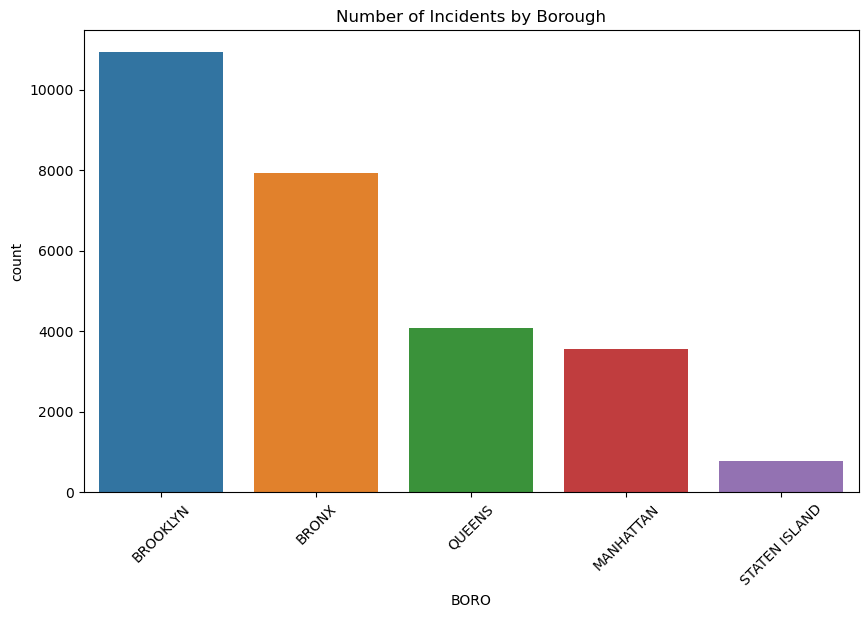

In [27]:
# Incident counts by borough (assuming 'BORO' column exists)
if 'BORO' in data.columns:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=data, x='BORO', order=data['BORO'].value_counts().index)
    plt.title('Number of Incidents by Borough')
    plt.xticks(rotation=45)
    plt.show()

Identifying boroughs with higher incident rates can help target resources and policies to those areas.

### 5-Distribution of Victim age Group

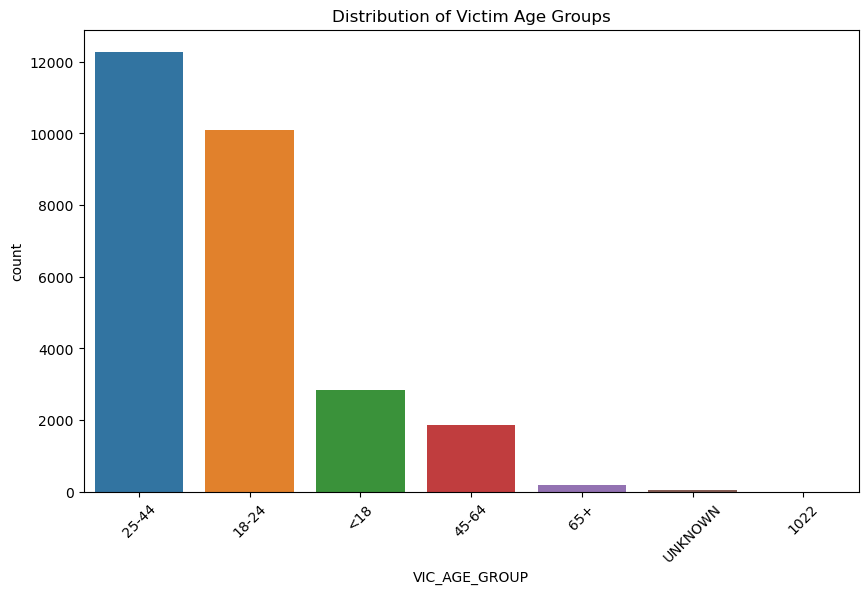

In [28]:
# Incident counts by victim age group (assuming 'VIC_AGE_GROUP' column exists)
if 'VIC_AGE_GROUP' in data.columns:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=data, x='VIC_AGE_GROUP', order=data['VIC_AGE_GROUP'].value_counts().index)
    plt.title('Distribution of Victim Age Groups')
    plt.xticks(rotation=45)
    plt.show()

 Understanding which age groups are most frequently victims can inform community outreach and protective measures.

### 6-Distribution Of Victim race

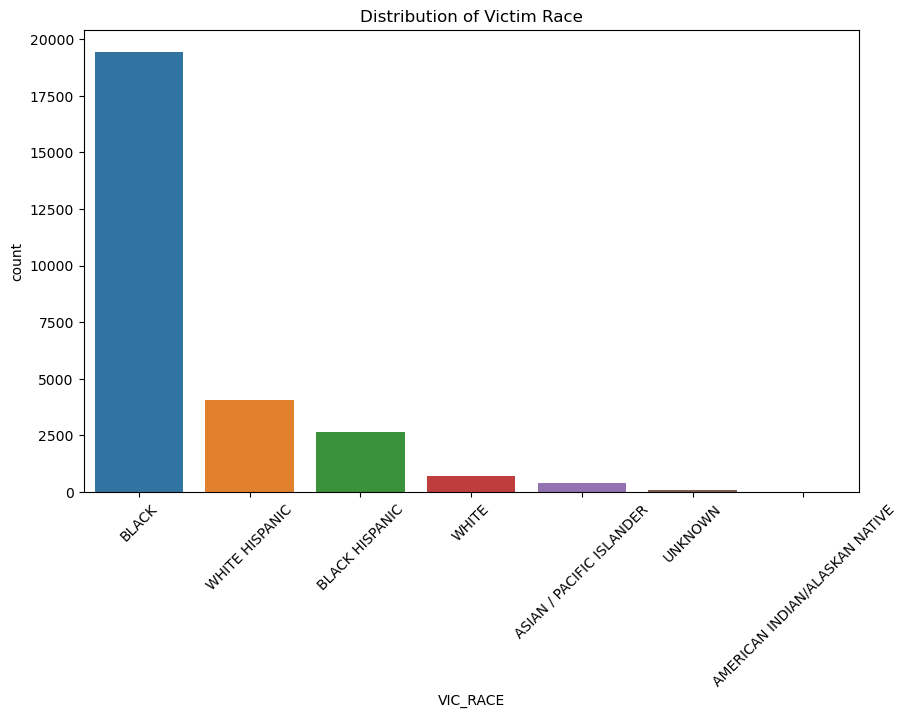

In [29]:
# Incident counts by victim race (assuming 'VIC_RACE' column exists)
if 'VIC_RACE' in data.columns:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=data, x='VIC_RACE', order=data['VIC_RACE'].value_counts().index)
    plt.title('Distribution of Victim Race')
    plt.xticks(rotation=45)
    plt.show()

This helps in understanding racial demographics affected by incidents, which can be crucial for addressing racial disparities and implementing fair policing practices.

### 7-Distribution Of Prepetrator Race

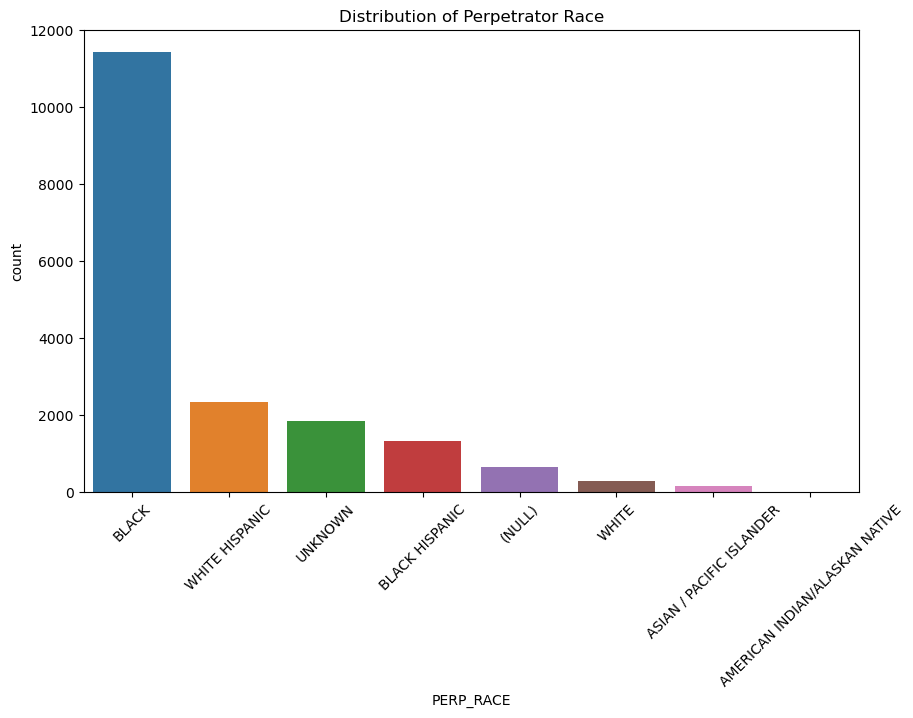

In [30]:
# Incident counts by perpetrator race (assuming 'PERP_RACE' column exists)
if 'PERP_RACE' in data.columns:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=data, x='PERP_RACE', order=data['PERP_RACE'].value_counts().index)
    plt.title('Distribution of Perpetrator Race')
    plt.xticks(rotation=45)
    plt.show()

Similar to victim race, this helps in understanding racial demographics involved in incidents and addressing any systemic issues.

### 8-Number Of incidents Over Time

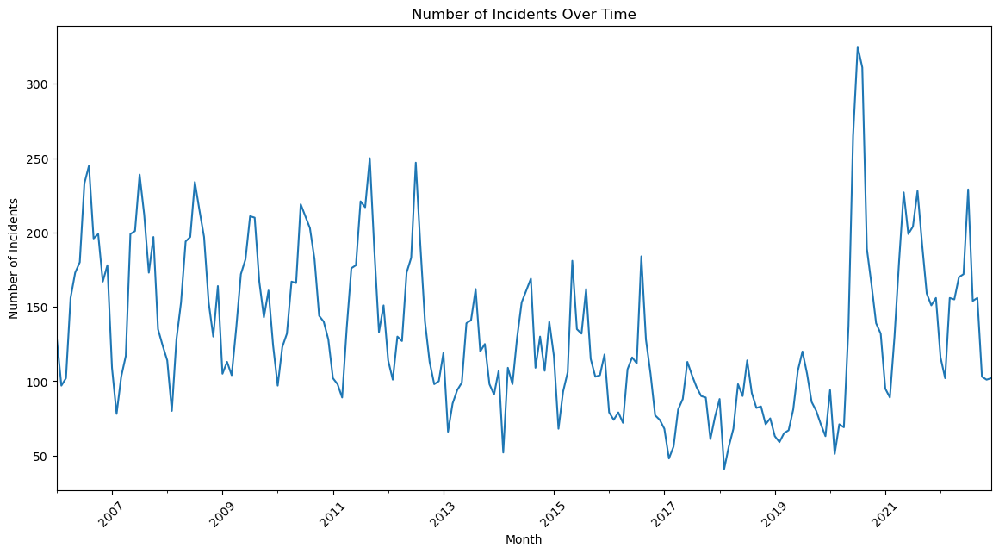

In [31]:
# Time series analysis: Number of incidents by month (assuming 'OCCUR_DATE' column exists)
if 'OCCUR_DATE' in data.columns:
    plt.figure(figsize=(14, 7))
    data['month'] = data['OCCUR_DATE'].dt.to_period('M')
    monthly_incidents = data.groupby('month').size()
    monthly_incidents.plot()
    plt.title('Number of Incidents Over Time')
    plt.xlabel('Month')
    plt.ylabel('Number of Incidents')
    plt.xticks(rotation=45)
    plt.show()

This can reveal seasonality or periodic spikes in incidents, which can be important for resource planning and preventive measures.

### 9-Number Of Incident By Precinct

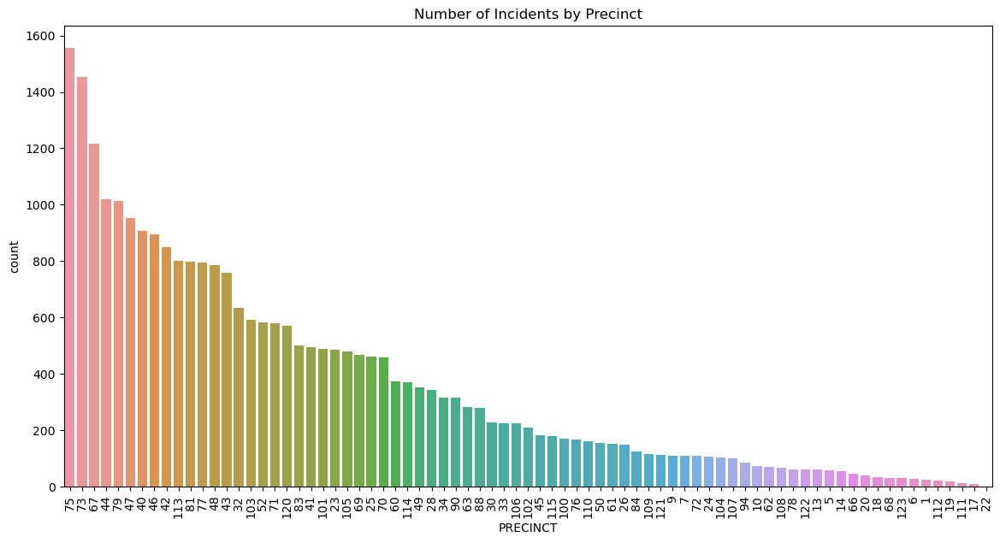

In [32]:
# Incident counts by location (assuming 'PRECINCT' column exists)
if 'PRECINCT' in data.columns:
    plt.figure(figsize=(14, 7))
    sns.countplot(data=data, x='PRECINCT', order=data['PRECINCT'].value_counts().index)
    plt.title('Number of Incidents by Precinct')
    plt.xticks(rotation=90)
    plt.show()

High incident rates in specific precincts indicate areas requiring more attention or different strategies to reduce incidents.

### 10-Relationship between Age Groups Of Prepetrators And Victims

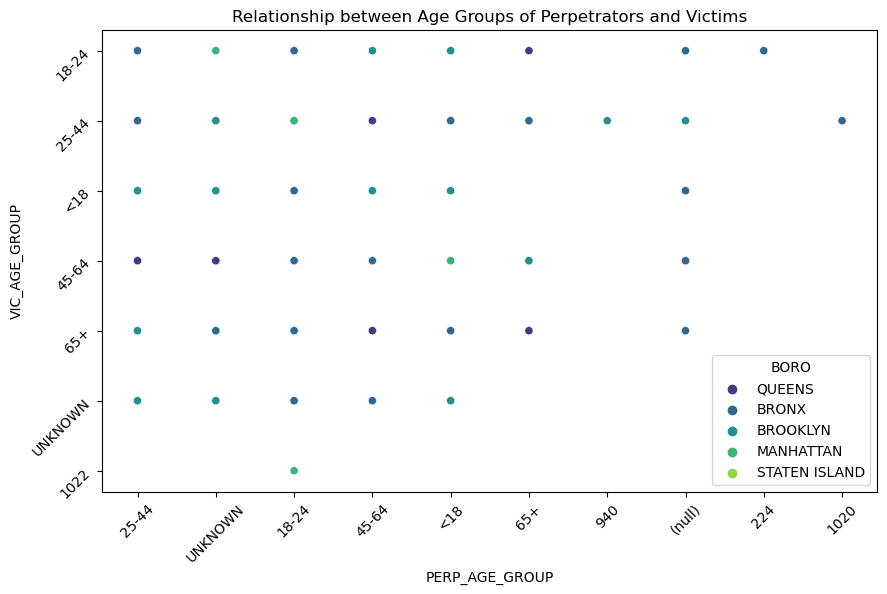

In [33]:
# Relationship between age groups of perpetrators and victims
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PERP_AGE_GROUP', y='VIC_AGE_GROUP', hue='BORO', data=data, palette='viridis')
plt.title('Relationship between Age Groups of Perpetrators and Victims')
plt.xticks(rotation=45)
plt.yticks(rotation=45)
plt.show()

### 11-Incidents by Location 

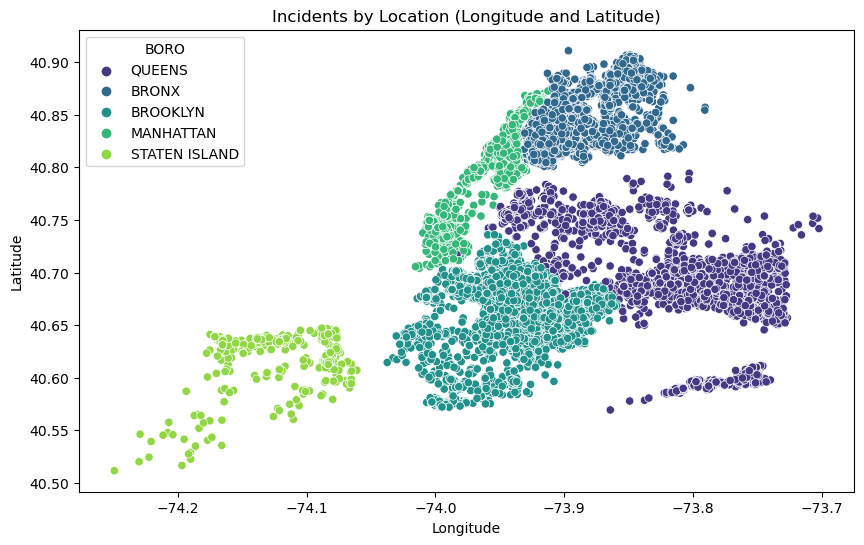

In [34]:
# Analyze relationship between location and incidents
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Longitude', y='Latitude', hue='BORO', data=data, palette='viridis')
plt.title('Incidents by Location (Longitude and Latitude)')
plt.show()

## Step 4: Predictive modeling - ML Algorithms

#### Developing
- K-Means Clustering

- DBSCAN Clustering

- Agglomerative Clustering

and compare them

### 1. K-Means Clustering

In [35]:
# Perform PCA to reduce dimensions for clustering
pca = PCA(n_components=2)
data_pca = pca.fit_transform(data_normalized)


In [36]:
# Function to plot clusters
def plot_clusters(data_pca, clusters, title):
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x=data_pca[:, 0], y=data_pca[:, 1], hue=clusters, palette='viridis')
    plt.title(title)
    plt.xlabel('PCA Component 1')
    plt.ylabel('PCA Component 2')
    plt.legend(title='Cluster')
    plt.show()

In [37]:
# Train the K-Means model
kmeans = KMeans(n_clusters=3, random_state=42)
clusters_kmeans = kmeans.fit_predict(data_pca)
data_cleaned['Cluster_KMeans'] = clusters_kmeans

In [38]:
# Evaluate KMeans with silhouette score
silhouette_kmeans = silhouette_score(data_pca, clusters_kmeans)
kmeans_davies_bouldin = davies_bouldin_score(data_pca, clusters_kmeans)
print(f'KMeans Silhouette Score: {silhouette_kmeans}')
print(f'K-Means Davies-Bouldin Index: {kmeans_davies_bouldin}')

KMeans Silhouette Score: 0.6753002348995024
K-Means Davies-Bouldin Index: 0.4602251734226222


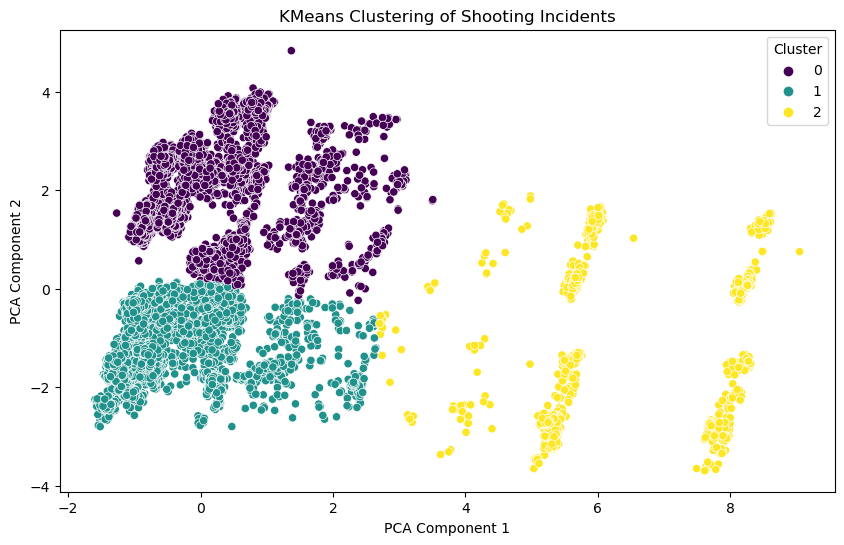

In [39]:
# Plot KMeans clusters
plot_clusters(data_pca, clusters_kmeans, 'KMeans Clustering of Shooting Incidents')

### 2. DBSCAN Clustering

In [40]:
# Train the DBSCAN model
dbscan = DBSCAN(eps=0.5, min_samples=3)
clusters_dbscan = dbscan.fit_predict(data_pca)
data_cleaned['Cluster_DBSCAN'] = clusters_dbscan

In [41]:
# Evaluate the DBSCAN model
dbscan_labels = clusters_dbscan[clusters_dbscan != -1]
dbscan_data_pca = data_pca[clusters_dbscan != -1]
if len(dbscan_labels) > 0:
    silhouette_dbscan = silhouette_score(dbscan_data_pca, dbscan_labels)
    dbscan_davies_bouldin = davies_bouldin_score(dbscan_data_pca, dbscan_labels)
    print(f'DBSCAN Silhouette Score: {silhouette_dbscan}')
    print(f'DBSCAN Davies-Bouldin Index: {dbscan_davies_bouldin}')
else:
    print('DBSCAN Silhouette Score: No clusters found')
    print('DBSCAN Davies-Bouldin Index: No clusters found')

DBSCAN Silhouette Score: 0.4509903582888999
DBSCAN Davies-Bouldin Index: 0.5264696717842082


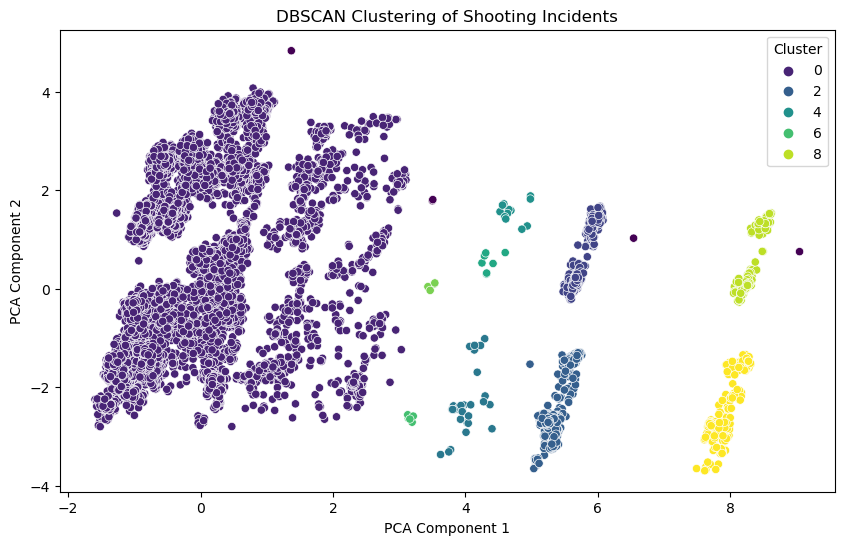

In [42]:
# Plot DBSCAN clusters
plot_clusters(data_pca, clusters_dbscan, 'DBSCAN Clustering of Shooting Incidents')

### 3. Agglomerative Clustering

In [43]:
# Train the Agglomerative Clustering model
agglo = AgglomerativeClustering(n_clusters=3)
clusters_agglo = agglo.fit_predict(data_pca)
data_cleaned['Cluster_Agglo'] = clusters_agglo

In [44]:
# Evaluate the Agglomerative Clustering model
silhouette_agglo = silhouette_score(data_pca, clusters_agglo)
agg_davies_bouldin = davies_bouldin_score(data_pca, clusters_agglo)
print(f'Agglomerative Clustering Silhouette Score: {silhouette_agglo}')
print(f'Agglomerative Clustering Davies-Bouldin Index: {agg_davies_bouldin}')

Agglomerative Clustering Silhouette Score: 0.6747824696530781
Agglomerative Clustering Davies-Bouldin Index: 0.46046291415153967


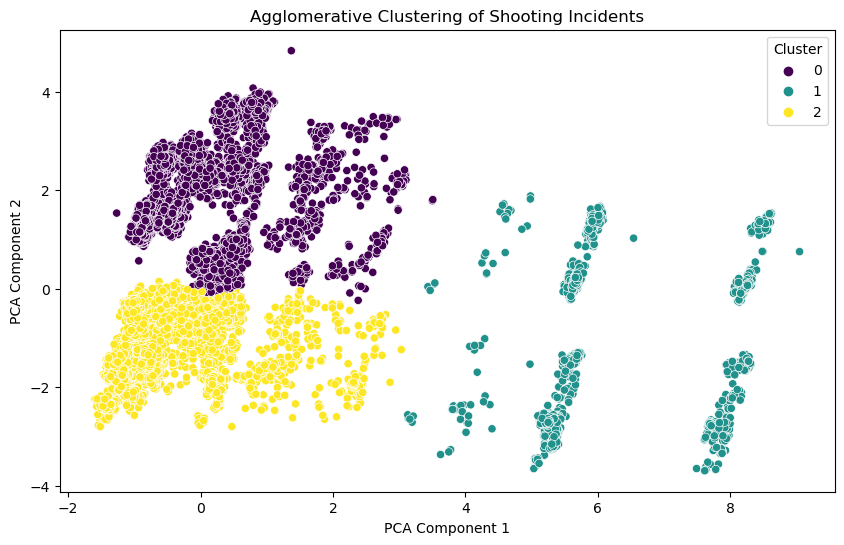

In [45]:
# Plot Agglomerative Clustering clusters
plot_clusters(data_pca, clusters_agglo, 'Agglomerative Clustering of Shooting Incidents')


### OBSERVATION
- Cluster Compactness: The optimal silhouette score for K-Means, Agglomerative Clustering, and DBSCAN indicates that the clusters are well-separated and compact.
- Cluster Separation: The optimal Davies-Bouldin Index for K-Means, Agglomerative, and DBSCAN Clustering suggests that the clusters are distinct and separated.
- Number of Clusters: The optimal number of clusters provides a balance between compactness and separation, leading to better-defined clusters.

## Step 5:  Visualization by Geographical Map

Visualization of clustered shooting incidents on a geographical map to identify spatial patterns and hotspots.

In [46]:
!pip install folium geopandas

In [47]:
import folium
from folium.plugins import MarkerCluster

In [48]:
# Filter out rows with missing Latitude or Longitude
filtered_data = data.dropna(subset=['Latitude', 'Longitude'])


In [49]:
# Verify no NaN values remain
print(filtered_data[['Latitude', 'Longitude']].isna().sum())


Latitude     0
Longitude    0
dtype: int64


In [50]:
# Extract the latitude and longitude values
coordinates = filtered_data[['Latitude', 'Longitude']].dropna()

In [51]:
# Define the number of clusters
num_clusters = 5

In [52]:
# Perform KMeans clustering
kmeans = KMeans(n_clusters=num_clusters, random_state=0)
filtered_data = filtered_data.dropna(subset=['Latitude', 'Longitude'])
filtered_data['Cluster'] = kmeans.fit_predict(coordinates)

In [53]:
# Create a base map centered around New York City
nyc_latitude = data['Latitude'].mean()
nyc_longitude = data['Longitude'].mean()
mymap = folium.Map(location=[nyc_latitude, nyc_longitude], zoom_start=11)

In [54]:
# Define a color palette for the clusters
colors = ['red', 'blue', 'green', 'purple', 'orange']

In [55]:
# Create a MarkerCluster for better visualization
marker_cluster = MarkerCluster().add_to(mymap)

In [56]:
# Add markers to the map
for _, row in filtered_data.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,
        color=colors[row['Cluster']],
        fill=True,
        fill_color=colors[row['Cluster']],
        fill_opacity=0.6
    ).add_to(marker_cluster)

In [57]:
# Display the map
display(mymap)